Mask R-CNN + FCN - Test on COCO Dataset - Run the Mask R-CNN net in inference mode, with the additional PCILayer that generates the context-based tensor 

# Setup Pipeline -  (build model and load weights)

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))
%matplotlib inline
%load_ext autoreload
%autoreload 2
import sys,os, pprint
pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())
if '..' not in sys.path:
    print("appending '..' to sys.path")
    sys.path.append('..')
    
import numpy as np
import mrcnn.utils     as utils
import mrcnn.visualize as visualize
from mrcnn.prep_notebook import build_fcn_evaluate_pipeline_coco, run_mrcnn_evaluate_pipeline, get_evaluate_batch
from mrcnn.visualize     import display_training_batch
from mrcnn.coco          import prep_coco_dataset
                             
# WEIGHT_FILE = 'F:/models/train_fcn8_coco_adam/fcn20181109T0000/fcn_0900.h5'
WEIGHT_FILE = 'last'

##------------------------------------------------------------------------------------
## Parse command line arguments
##------------------------------------------------------------------------------------
input_parms = " --batch_size     1  "
input_parms +=" --dataset        coco2014 "
input_parms +=" --mrcnn_logs_dir train_mrcnn_subset "
input_parms +=" --fcn_logs_dir   train_fcn8L2_BCE_subset "
input_parms +=" --mrcnn_model    last "
input_parms +=" --fcn_model      last "
input_parms +=" --fcn_layer      all"
input_parms +=" --fcn_arch       fcn8L2 " 
input_parms +=" --sysout         screen "
input_parms +=" --scale_factor   4"
input_parms +=" --coco_classes   78 79 80 81 82 44 46 47 48 49 50 51 34 35 36 37 38 39 40 41 42 43 10 11 13 14 15 "
eval_method = '1'
input_parms +=" --evaluate_method "+eval_method

parser = utils.command_line_parser()
args = parser.parse_args(input_parms.split())
utils.display_input_parms(args)

Current working dir:  E:\git_projs\mrcnn3\notebooks
appending '..' to sys.path


D:\Anaconda3\envs\TFG\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


 Init Image Class - Possible Object Choices:  {'sun': 1, 'car': 3, 'tree': 5, 'person': 5, 'cloud': 3, 'building': 3, 'airplane': 3, 'truck': 3}
 Init Image Class - Custom Color Keys      :  ['sun', 'cloud', 'ground', 'sky', 'person', 'tree']
 Init Image Class - Object Priority List   :  ['building', 'tree', 'car']
 Init Image Class - BUILD_MAX_TRIES        :  7
 Init Image Class - PERSON_CAR_DISTANCE    :  10

   Arguments passed :
   --------------------
   batch_size                     1
   coco_classes                   [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
   dataset                        coco2014
   epochs                         1
   evaluate_method                1
   fcn_arch                       FCN8L2
   fcn_bce_loss_class             0
   fcn_bce_loss_method            1
   fcn_layers                     ['all']
   fcn_logs_dir                   train_fcn8L2_BCE_subset
   fcn_losses                   

In [2]:
mrcnn_model, fcn_model = build_fcn_evaluate_pipeline_coco(args = args,verbose = 0)


--> Execution started at: 05-14-2019 @ 12:48:14
    Tensorflow Version: 1.8.0   Keras Version : 2.1.6 
>>> Initialize Paths
 Linx  Linux
 *** Keras Training mode: Tensor("keras_learning_phase:0", shape=(), dtype=bool)
 *** Keras Training mode after setting: 0
>>> Initialize ModelBase model 
   Mode      :  evaluate
   Model dir :  /home/kbardool/models_coco/train_mrcnn_subset
>>> ModelBase initialiation complete
>>> ---Initialize MRCNN model, mode:  evaluate
 load class+predcition_info from : /home/kbardool/PretrainedModels/coco2014_class_stats_info.pkl

----------------------------
>>> Resnet Graph 
----------------------------
     Input_image shape : (?, 1024, 1024, 3)
self.verbose: 0

>>> Feature Pyramid Network (FPN) Graph 

>>> RPN Layer 

>>> RPN Outputs  <class 'list'>
      rpn_class_logits/rpn_class_logits:0
      rpn_class/rpn_class:0
      rpn_bbox/rpn_bbox:0

>>> Proposal Layer - generate  1000  proposals
    Init complete. Size of anchors:  (261888, 4)

>>> FPN Classifie

    Weights file loaded: /home/kbardool/models_coco/train_mrcnn_subset/mrcnn20181220T0000/mrcnn_0385.h5 
MRCNN  MODEL Load weight file COMPLETE 
-----------------------------------------------
 Load Model with init parm: [ last ]
-----------------------------------------------
 ---> last
>>> load_weights() from : /home/kbardool/models_coco/train_fcn8L2_BCE_subset/fcn20190120T0000/fcn_4345.h5
    Weights file loaded: /home/kbardool/models_coco/train_fcn8L2_BCE_subset/fcn20190120T0000/fcn_4345.h5 
FCN  MODEL Load weight file COMPLETE 
 *** Keras Training mode after setting: 0


In [5]:
# print("\nConfiguration Parameters:")
# print("-------------------------")
# for a in dir(fcn_config2):
#     if not a.startswith("__") and not callable(getattr(fcn_config2, a)):
#         print("{:30} {}    {}".format(a, getattr(fcn_config2, a) == getattr(fcn_model.config, a), getattr(fcn_config2, a), getattr(fcn_model.config, a) ))
# print("\n")

# mrcnn_model.config.display()

##  Print some information about the model 

In [ ]:
# for layer in model.keras_model.layers
#     print layer.name 

layers    = [layer for layer in mrcnn_model.keras_model.layers]          # all layer outputs
print(len(layers))

for idx in range(200, len(layers)):
    print( ' layer: {} name: {}'.format(idx, layers[idx].name))
#     print(' layer {} :  {}'.format(idx,layers[idx]))
#     print(' Number of inbound nodes: ', end ='')
#     pp.pprint(len(layers[idx]._inbound_nodes))
#     pp.pprint(layers[idx].__dict__)
#     print('-------------------------------------------')
print('idx : ', idx)
pp.pprint(layers[idx].__dict__)

print()
pp.pprint(layers[idx]._inbound_nodes[0].__dict__)

####  Print Layer & Weight Info

In [ ]:
# keras_model = mrcnn_model.keras_model
# layers = keras_model.inner_model.layers if hasattr(keras_model, "inner_model") else keras_model.layers
# print(dir(layers[0]))
# pp.pprint(layers[7].weights)
print()
for i in range(len(layers)):
    print('\n{:3d} {:20s} Weights: {}'.format(i, layers[i].name, len(layers[i].weights))) ## [weight.name for weight in layers[i].weights]))
    print('{:23s}  Trainable: {} '.format(' ',[weight.name for weight in layers[i].trainable_weights]))
    for weight in layers[i].weights:
        print('{:25s} {:30s} {}  '.format(' ',weight.name,  weight.shape))

####  More layer information

In [ ]:
import pprint
pp = pprint.PrettyPrinter(indent=2, width=100)
np.set_printoptions(linewidth=100,precision=4,threshold=1000, suppress = True)

# model.compile_only(learning_rate=config.LEARNING_RATE, layers='heads')
# print('\n Metrics (_get_deduped_metrics_names():) ') 
# pp.pprint(mm._get_deduped_metrics_names())
# print('\n Losses (model.metrics_names): ') 
# pp.pprint(mm.metrics_names)
# KB.set_learning_phase(0)
# print(' Learning phase values is L ' ,KB.learning_phase())
# print('\Layers ', len(mrcnn_model.keras_model.layers))
# pp.pprint(mrcnn_model.keras_model.layers)

print('\n Weights: ') 
## Get weieights acturally returns weight dims
# print(' Number of weights arrays: ',len(mrcnn_model.keras_model.get_weights()))
print(' length of model.keras_model.weights', len(mrcnn_model.keras_model.weights))
# for i,j in enumerate(mrcnn_model.keras_model.weights):
#     print(i, j) # j.name, j.shape, j.dtype)
# pp.pprint(mrcnn_model.keras_model.weights)
# pp.pprint(type(mrcnn_model.keras_model.get_weights()))

# pp.pprint(dir(model.keras_model))
# print(mrcnn_model.keras_model.weights[1])

#### List trainable layers using `get_trainable_layers()`

In [ ]:
for i in  mrcnn_model.get_trainable_layers():
    print(' Layer:', i.name)       

####  Get a list of trainable layers, i.e., layers that have weights

In [ ]:
# trainable = mrcnn_model.get_trainable_layers()
layers    = [layer for layer in mrcnn_model.keras_model.layers]          # all layer outputs
print('Trn  Idx   Layer Name   \t\t InputNode LayerNames \t\t InputNode LayerShapes')
for idx, layer in enumerate(layers):
    TrnFlg = 'T' if layer.get_weights() else ' '
    all_input_shapes = [node.input_shapes   for node in layer._inbound_nodes][0]
    input_nodes  = [node for node in layer._inbound_nodes]
    all_nodes_layers  = [node.inbound_layers for node in input_nodes]   
#     print(all_input_nodes)
#     all_nodes_layers  = [[node.inbound_layers for node in input_nodes]  for input_nodes in layer._inbound_nodes]  #[node for node in all_input_nodes]]]
    all_input_layer_names = [[layer.name for layer in node_layers] for node_layers in all_nodes_layers][0]        
    str_names = ','.join(map(str, all_input_layer_names)) 
    str_shapes = ','.join(map(str, all_input_shapes)) 
    print(' {} ; {:3d} ; {:25s}; {:30s}; {:30s} '.format( TrnFlg, idx, layer.name,  str_names, str_shapes))

In [ ]:
print()    
for i in range(194,len(layers)):
# for i in [206]:
    layer = layers[i]
    print('====================================================='.format(i))
    print('== Layer {} : {} '.format(i,layer.name))
    print('====================================================='.format(i))
    pp.pprint(layer.__dict__)
    print()
    for j,node in enumerate(layer._inbound_nodes):
        print('== Inbound Node {} ========================================='.format(j))
        print(type(node))
        pp.pprint(node.__dict__)
        node_inlayers_names = [n.name for n in node.inbound_layers]
        print(node_inlayers_names)

## Build test datasets

In [3]:
print('load coco classes: ', args.coco_classes)
##------------------------------------------------------------------------------------------------------------
## Build & Load Training and Validation datasets  loadAnns='active_only' | 'all_classes'
## train  : 82081 |  train + val35k : 117266 | val    : 40137 | val35k : 35185 |  minival:  4952
##------------------------------------------------------------------------------------------------------------ 
#   'accessory':   [27, 28, 31, 32, 33],          # 'animal':     [16, 17, 18, 19, 20, 21, 22, 23, 24, 25],
#   'appliance':  [78, 79, 80, 81, 82],           # 'background': [0],
#   'electronic': [72, 73, 74, 75, 76, 77],       # 'food':       [52, 53, 54, 55, 56, 57, 58, 59, 60, 61],
#   'furniture':  [62, 63, 64, 65, 67, 70],       # 'indoor':     [84, 85, 86, 87, 88, 89, 90],
#   'kitchen':    [44, 46, 47, 48, 49, 50, 51],   # 'outdoor':    [10, 11, 13, 14, 15],
#   'person':     [1],                            # 'sports':     [34, 35, 36, 37, 38, 39, 40, 41, 42, 43],
#   'vehicle':    [2, 3, 4, 5, 6, 7, 8, 9]} 
## " --coco_classes:
##    appliance : 78 79 80 81 82                  kitchen: 44 46 47 48 49 50 51 
##    sports    : 34 35 36 37 38 39 40 41 42 43   indoor : 10 11 13 14 15
##------------------------------------- -----------------------------------------------------------------------
# dataset_train, train_generator = prep_coco_dataset(["train", 'val35k'], mrcnn_model.config, generator = True, shuffle = False,load_coco_classes=args.coco_classes, 
#                                                   loadAnns = 'all_classes'
#                                                    loadAnns='active_only')
dataset_test, test_generator = prep_coco_dataset(["minival"], mrcnn_model.config, generator = True, shuffle = False,load_coco_classes=args.coco_classes, 
#                                                   loadAnns = 'all_classes'
                                                   loadAnns='active_only')
class_names = dataset_test.class_names

# dataset_test.display_active_class_info()
print("Testing Dataset Image Count: {}".format(len(dataset_test.image_ids)))
print("Testing Dataset Class Count: {}".format(dataset_test.num_classes))
class_names = dataset_test.class_names

load coco classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
          !!! Loading annotations for ACTIVE CLASSES ONLY !!!
 Dataset dir :  /home/kbardool/MLDatasets/coco2014  subset:  minival
loading annotations into memory...
Done (t=0.66s)
creating index...
index created!
 load subset of classes:  [78, 79, 80, 81, 82, 44, 46, 47, 48, 49, 50, 51, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 10, 11, 13, 14, 15]
 image dir            :  /home/kbardool/MLDatasets/coco2014/val2014
 json_path_dir        :  /home/kbardool/MLDatasets/coco2014/annotations/instances_minival2014.json
 number of images     :  2416
 image_ids[:10]       :  [532481, 385029, 311303, 393226, 532493, 458768, 327701, 434204, 24610, 344100]
 image_ids[1000:1010] :  [527695, 322895, 175438, 314709, 109916, 355677, 273760, 216419, 52591, 290163]
Prepares complete
Testing Dataset Image Count: 2416
Testing Dataset Class Count: 81


###  Display some images from dataset

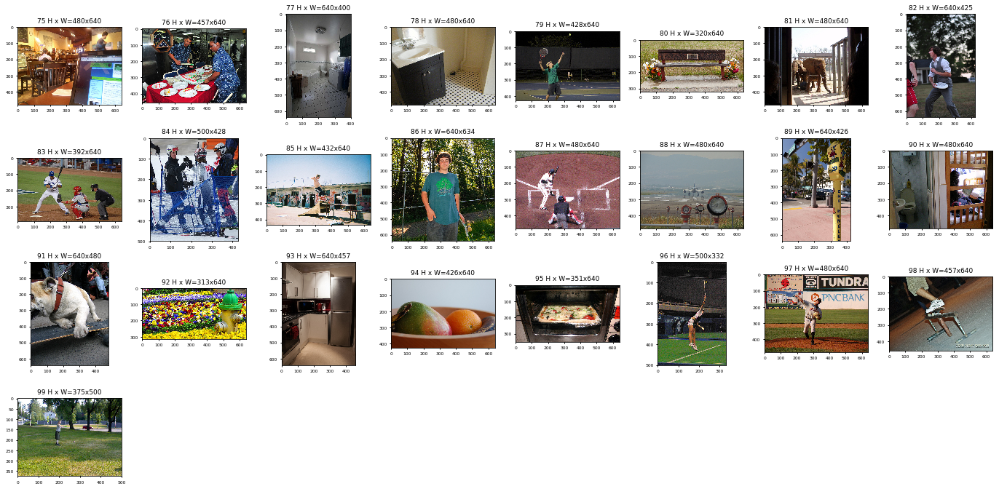

In [4]:
from mrcnn.prep_notebook import get_image_batch
image_list = list(range(75,100))
image_titles = [str(i) for i in image_list]
images = get_image_batch(dataset_test, image_list)
visualize.display_images(images, titles = image_titles, cols = 8, width = 24)

## Display Images

### Load using next(generator)

In [ ]:
test_batch_x, _ = next(test_generator)
display_training_batch(dataset_test, test_batch_x)
# dataset_train.display_annotation_info(0)

### Load a specific image using image_id -Display image with Ground Truth bounding boxes and masks

image id :  30533
 Image_id    :  30533  Reference:  http://cocodataset.org/#explore?id=488487 Coco Id: 488487
 Image meta  :  [30533   480   640     3   128     0   896  1024]
 Class ids   :  (2,)    [35 36]
 Class Names :  ['baseball bat', 'baseball glove']


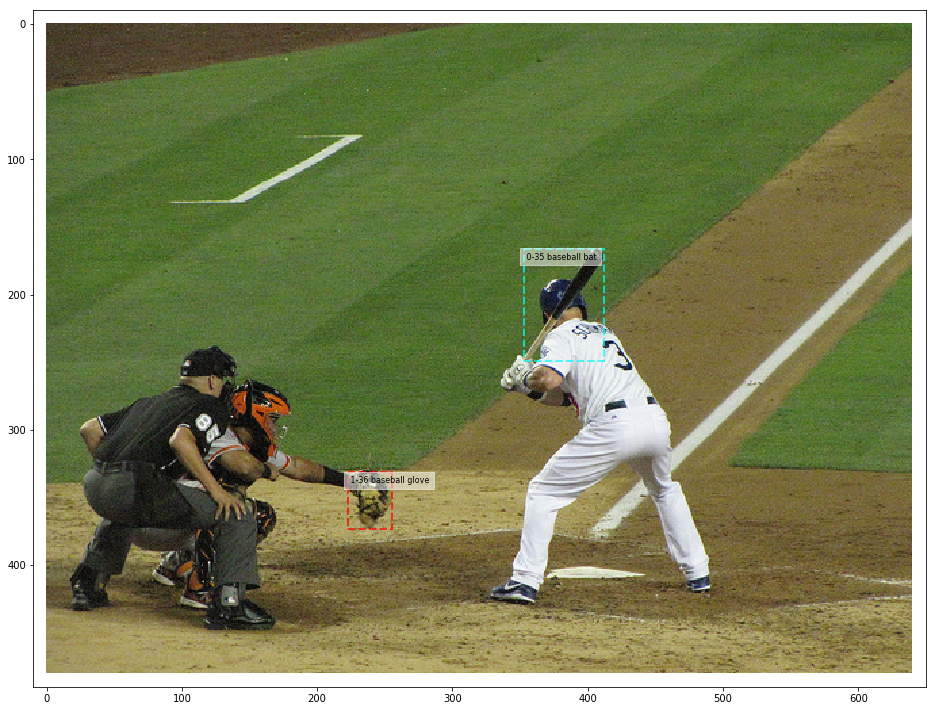

In [10]:
## 62642 (persons),   68539 (trucks) 36466 (surfers)  75040 (boat and persons)
## 36466 surfers. 5498 basketbal players, 27711,30531
## 5498 lots of motorcylces & persons - 
## Persons: #26026, #7719, 111864, 58240,  
## 35347 - laptops, keyboards and cat
## items = [59199 , 102868]
## 89243: Person, bicylce and traiffic lights
## 101623 (cake and forks), 41423 (elephant & people)
## 33477 Table, bowl, cup, sandwich, knife
## 26763 Table, chair, cup , bowl, bottle
## 49316 Table, book, backpack, many bottles
## 12902 Car , truck and traffic light tree
## 57327 person and horses
## 26026 -- mountain, skiers, skiboards 
##  7719 -- people, bottles, handbags
## 27711 -- persons and boats
## 18045 -- person     
## 36769 -- people in meeting room with a 'giraffe'detection?
##  8634 -- person
## 30531 -- tennis players 
##  8645 -- two people
# IMAGE_LIST = [75040] 
# IMAGE_LIST = [89243]
# IMAGE_LIST = [33477]
# IMAGE_LIST = [29731]
# IMAGE_LIST = [26763]
# IMAGE_LIST = [89243]   ## 89243: Person, bicylce and traiffic lights
# IMAGE_LIST = [43168]   ## 43168 Multiple umbrella, chairs, beds

# IMAGE_LIST = [10]
IMAGE_LIST = [30533]
# IMAGE_LIST= [30531]
# IMAGE_LIST= [7143]
# del images, train_batch_x
# train_batch_x = get_evaluate_batch(dataset_train, mrcnn_model.config, generator = train_generator )
eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, image_ids = IMAGE_LIST)

# train_batch_x, _ =  data_gen_simulate(dataset_train, mrcnn_model.config, IMAGE_LIST)
# visualize.display_training_batch(dataset_train, train_batch_x)
# dataset_train.display_annotation_info(IMAGE_LIST)
 

### Load an image using `get_evaluate_batch()`

 Random selection of images:  [44236]
 Image_id    :  44236  Reference:  http://cocodataset.org/#explore?id=269395 Coco Id: 269395
 Image meta  :  [     44236        338        451          3        128          0        895       1024]
 Class ids   :  (7,)    [        44         46         46         56         61         61         74]
 Class Names :  ['knife', 'bowl', 'bowl', 'cake', 'dining table', 'dining table', 'book']


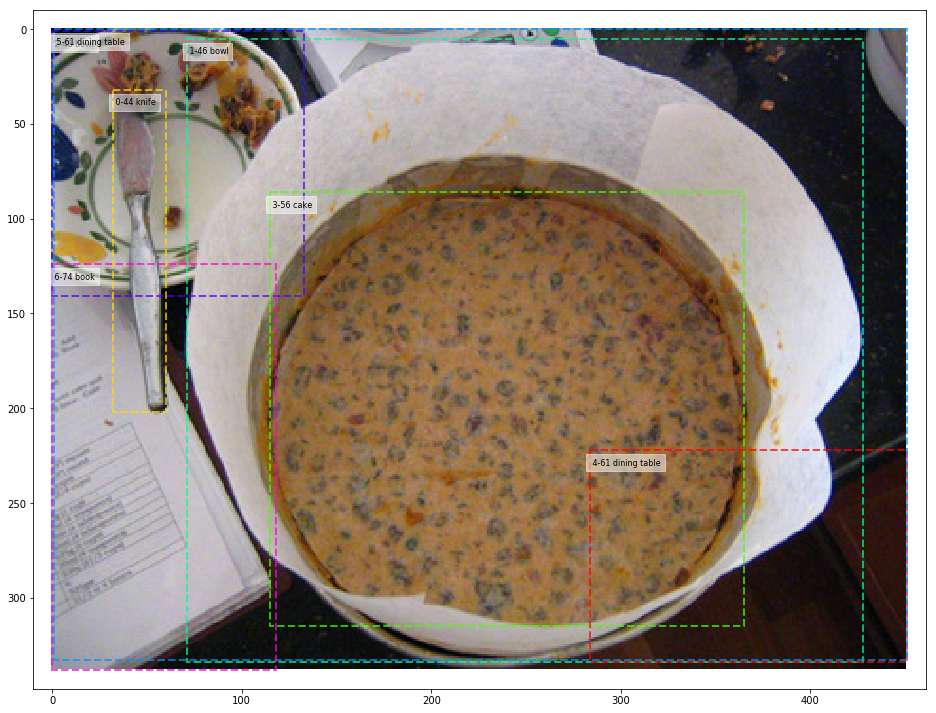

In [25]:
# from mrcnn.prep_notebook import get_evaluate_batch
# from mrcnn.prep_notebook import get_training_batch, get_inference_batch, get_evaluate_batch

# eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, generator = test_generator, display = True)
# eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, image_ids = [7143], display = True)
# eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, display = True)

In [5]:
# import mrcnn.dataset as dataset
# img = dataset.load_image(7143)
# visualize.display_image(img)


# Run FCN evaluation pipeline

##  Run FCN detection pipeline on first image

###  Run `fcn_model.evaluate()`

In [6]:
np_format = { 'float' : lambda x: "%10.4f" % x,
              'int'   : lambda x: "%10d" % x}
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)

image id :  95
 Image_id    :  95  Reference:  http://cocodataset.org/#explore?id=172396 Coco Id: 172396
 Image meta  :  [        95        351        640          3        231          0        793       1024]
 Class ids   :  (1,)    [        70]
 Class Names :  ['oven']


list

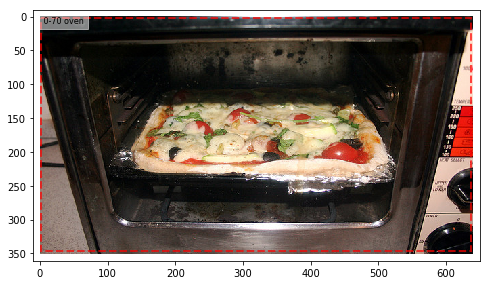

In [12]:
from mrcnn.prep_notebook import get_evaluate_batch
IMAGE_ID = 95
test_batch = get_evaluate_batch(dataset_test,mrcnn_model.config, IMAGE_ID, display=True)
# image = get_image_batch(dataset_test, 10, display=True)
type(test_batch)

<class 'numpy.ndarray'> (1, 351, 640, 3) float32 0.0 255.0
<class 'numpy.ndarray'> (1, 1024, 1024, 3) float32 -123.7 151.1
<class 'numpy.ndarray'> (1, 89) int64 0 1024
<class 'numpy.ndarray'> (1, 100) int32 0 70
<class 'numpy.ndarray'> (1, 100, 4) int32 0 1021


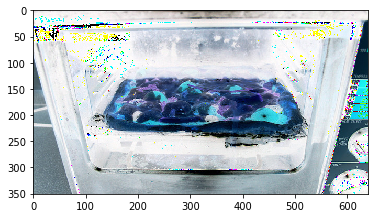

In [13]:
# r = results[0]
import matplotlib.pyplot as plt
for i in test_batch:
    print(type(i), i.shape, i.dtype, i.min(), i.max())
plt.imshow(test_batch[0][0])

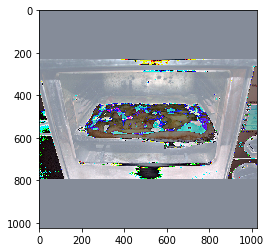

In [14]:
plt.imshow(test_batch[1][0].astype(np.uint8))
# print(r['class_ids'])
# print(r['pr_hm_scores'][39])

In [15]:
from mrcnn.prep_notebook import run_mrcnn_evaluation, run_fcn_evaluation

image_id = 95   # 434
print(mrcnn_model.mode)
fcn_results = run_fcn_evaluation(fcn_model, mrcnn_model, dataset_test, image_id, verbose = 0)  
r = fcn_results[0]

evaluate


In [ ]:


# fcn_results = fcn_model.evaluate(mrcnn_model, eval_batch, verbose = 0)
# print(' Complete')

In [16]:
fcn_results[0].keys()
for i, r in enumerate(fcn_results):
    print('\n output ', i, '  ',sorted(r.keys()))
    for key in sorted(r):
        print(key.ljust(20), r[key].shape)        


 output  0    ['class_ids', 'detection_ind', 'detections', 'fcn_hm', 'fcn_hm_scores', 'fcn_scores', 'fcn_scores_by_class', 'fcn_sm', 'gt_bboxes', 'gt_class_ids', 'image', 'image_meta', 'molded_image', 'molded_rois', 'pr_hm', 'pr_hm_scores', 'pr_scores', 'pr_scores_by_class', 'rois', 'scores']
class_ids            (2,)
detection_ind        (2,)
detections           (200, 7)
fcn_hm               (256, 256, 81)
fcn_hm_scores        (81, 200, 24)
fcn_scores           (2, 24)
fcn_scores_by_class  (81, 200, 24)
fcn_sm               (256, 256, 81)
gt_bboxes            (100, 4)
gt_class_ids         (100,)
image                (351, 640, 3)
image_meta           (89,)
molded_image         (1024, 1024, 3)
molded_rois          (2, 4)
pr_hm                (256, 256, 81)
pr_hm_scores         (81, 200, 24)
pr_scores            (2, 24)
pr_scores_by_class   (81, 200, 24)
rois                 (2, 4)
scores               (2,)


fcn_scores
[[    1.0000     1.0000   346.0000   637.0000    70.0000     0.7435     1.0000   200.0000
      1.0000  -256.8409 35057.3750  -256.8409]
 [    0.0000     1.0000   275.0000   542.0000    70.0000     0.7424    -1.0000   199.0000
      0.9985  -170.1937 25355.3125  -169.9419]]
pr_scores
[[    1.0000     1.0000   346.0000   637.0000    70.0000     0.7435     1.0000   200.0000
      1.0000     1.0000 35057.3750     1.0000]
 [  -17.0000     1.0000   275.0000   542.0000    70.0000     0.7424    -1.0000   199.0000
      0.9985     1.0000 25355.3125     0.9985]]
------------
fcn_scores_by_class
[[0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000]
 [0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000]
 [0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000]
 [0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000]
 [0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000 0.0000]
 [0.0000 0.0000 0.0000 0.0000 0

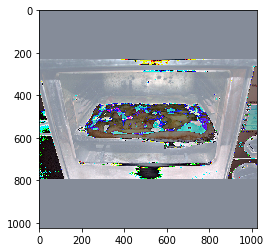

In [17]:
print('fcn_scores')
print(r['fcn_scores'][:,:12])
print('pr_scores')
print(r['pr_scores'][:,:12])
print('------------')

print('fcn_scores_by_class')
print(r['fcn_scores_by_class'][31,:15,:10])
print('pr_scores_by_class')
print(r['pr_scores_by_class'][31,:15,:10])

print('------------')
print('fcn_hm_scores')
print(r['fcn_hm_scores'][31,:15,:10])
print('pr_hm_scores')
print(r['pr_hm_scores'][31,:15,:10])
print()
print(r['rois'])

plt.imshow(r['molded_image'].astype(np.uint8))


# print(r['pr_hm_scores'][31,:15,:8])

In [12]:
NORM_SCORE_COLUMN = 8
for  pr_score, fcn_score in zip(np.round(r['pr_scores'],4), np.round(r['fcn_scores'],4) ):
    print('pr_score  :',pr_score)
    print('fcn_score :',fcn_score)
    # assert np.all(pr_score[:NORM_SCORE_COLUMN] == fcn_score[:NORM_SCORE_COLUMN]), 'FCN_SCORE[:8] {:f}<> PR_SCORE[:8]{:f}'
    if not  np.all(pr_score[:NORM_SCORE_COLUMN] == fcn_score[:NORM_SCORE_COLUMN]):
        print('FCN_SCORE[:8] {:f}<> PR_SCORE[:8]{:f}')
        print('pr_score  :',pr_score[:NORM_SCORE_COLUMN])
        print('fcn_score :',fcn_score[:NORM_SCORE_COLUMN])


pr_score  : [  -17.0000     1.0000   275.0000   542.0000    70.0000     0.7436    -1.0000   200.0000     1.0000     1.0000 25355.3125     1.0000   240.8553   336.0000     0.7168     0.8544     0.8593
     0.9942   240.8553   336.0000     0.7168     0.8544     0.8593     0.9942]
fcn_score : [    0.0000     1.0000   275.0000   542.0000    70.0000     0.7436    -1.0000   200.0000     1.0000  -170.1845 25355.3125  -170.1845     1.8986   336.0000     0.0057     0.5418     0.8593
     0.6305    82.6297   336.0000     0.2459     0.5418     0.8593     0.6305]
FCN_SCORE[:8] {:f}<> PR_SCORE[:8]{:f}
pr_score  : [  -17.0000     1.0000   275.0000   542.0000    70.0000     0.7436    -1.0000   200.0000]
fcn_score : [    0.0000     1.0000   275.0000   542.0000    70.0000     0.7436    -1.0000   200.0000]
pr_score  : [    1.0000     1.0000   346.0000   637.0000    70.0000     0.7431     1.0000   199.0000     0.9993     1.0000 35057.3750     0.9993   281.9094   391.0000     0.7210     1.0000     1.0000


### Display FCN detections

In [21]:
np_format = {}
float_formatter = lambda x: "%10.4f" % x
int_formatter   = lambda x: "%10d" % x
np_format['float'] = float_formatter
np_format['int']   = int_formatter
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)

In [14]:
# f = fcn_results[0]
# print(f['detections'][:20])
# # print(f['gt_bboxes'][:20])
# print(f['gt_class_ids'])

#### Display MRCNN results - 1st style

In [22]:
import mrcnn.visualize_2 as vis2
f = fcn_results[0]
vis2.display_pr_fcn_style1(f, class_names, lmt = 17)

         bbox seq id : [       200        199]
  f[class_ids] class : [        70         70]
   f[pr_score] class : [        70         70]
  f[fcn_score] class : [        70         70]
                              oven       oven
           TP/FP Ind : [         1         -1]
      pr  orig score : [    0.7438     0.7434]
      fcn orig score : [    0.7438     0.7434]
      cls norm score : [    1.0000     0.9995]
           bbox area : [35057.3750 25355.3125]
           clip area : [  391.0000   336.0000]

-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
  pr norm_score [8]  : [    1.0000     0.9995]
  fcn norm_score[8]  : [    1.0000     0.9995]

     pr_score_0 [11] : [    1.0000     0.9995]
    fcn_score_0 [11] : [ -256.8182  -170.0802]

     pr_score_1 [14] : [    0.7215     0.7164]
    fcn_score_1 [14] : [    0.0090     0.0056]

     pr_scor

####  Display MRCNN scores - 2nd style

In [77]:
# f = fcn_results[0]
# for i, [molded_bbox, cls, scr, pr_scr, fcn_scr] in enumerate(zip(f['molded_rois'].astype(np.int), f['class_ids'],  f['scores'], f['pr_scores'], f['fcn_scores'])):
    
#     print('{} {} {:2d}  {:.<18s}  {:5.4f} {}  '.format(i, molded_bbox, cls, dataset_test.class_names[cls], scr, fcn_scr[[4,5,6,7,8]]))
#     print('{:>86s} {}'.format(' mrcnn old style scores:  ',  pr_scr[[9,10,11]]))
#     print('{:>86s} {}'.format('   fcn old style scores:  ', fcn_scr[[9,10,11]]))
#     print()
#     print('{:>86s} {}'.format('      mrcnn alt scores1:  ', pr_scr[[12,13,14,15,16,17]]))
#     print('{:>86s} {}'.format('        fcn alt scores1:  ', fcn_scr[[12,13,14,15,16,17]]))
#     print()
#     print('{:>86s} {}'.format('          mrcnn_scores2:  ', pr_scr[[18,19,20,21,22,23]]))
#     print('{:>86s} {}'.format('            fcn_scores2:  ', fcn_scr[[18,19,20,21,22,23]]))
#     print()

####  Display MRCNN scores - 3rd style

In [16]:
# r = results[0]
print(f['detections'].shape)
print('   old_scores: (gauss. sum over large bbox/bbox area/ gauss_sum * normlzd_score))')
print('  alt_scores 1: (gauss. sum over small mask/mask area/ gauss_sum / mask_area):  ')
sort_by_class_order = np.argsort(f['class_ids'])


# for i in range(len( f['class_ids'])):
for i in sort_by_class_order:
#     print(i , f['rois'][i].astype(np.float), f['scores'][i], f['class_ids'][i], class_names[f['class_ids'][i]])
#     print(i , f['detections'][i], f['class_ids'][i], class_names[f['class_ids'][i]])
    det_type = '       --> ADDED FP ' if f['pr_scores'][i,6] == -1 else '      Original detection'
    print(i , f['rois'][i])
    print(i , f['pr_scores'][i,:9], f['pr_scores'][i,4], class_names[ f['pr_scores'][i,4].astype(np.int)], det_type) 
    print()
    print(i , 'pr: old_scores [9,10,11]:  '.rjust(90), f['pr_scores'][i,9:12])    
    print(i , '  alt_scores 1 [12 - 17]:  '.rjust(90), f['pr_scores'][i,12:18])    
    print(i , '  alt_scores 2 [18 - 23]:  '.rjust(90), f['pr_scores'][i,18:24])    
    print(i)
#     print(i , f['fcn_scores'][i,:8], f['fcn_scores'][i,4], class_names[ f['fcn_scores'][i,4].astype(np.int)])    
    print(i , 'fcn: old_scores [9,10,11]:  '.rjust(90), f['fcn_scores'][i,9:12])    
    print(i ,  '  alt_scores 1 [12 - 17]:  '.rjust(90), f['fcn_scores'][i,12:18])    
    print(i ,  '  alt_scores 2 [18 - 23]:  '.rjust(90), f['fcn_scores'][i,18:24])    
    print()
    print(i , '  old score [11]:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(f['pr_scores'][i,11],f['fcn_scores'][i,11]))
    print(i , 'alt score 1 [14]:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(f['pr_scores'][i,14],f['fcn_scores'][i,14]))
    print(i , 'alt score 2 [20]:  '.rjust(90), ' from mrcnn:{:10.4f}  from FCN: {:10.4f} '.format(f['pr_scores'][i,20],f['fcn_scores'][i,20]))
    print()

(200, 7)
   old_scores: (gauss. sum over large bbox/bbox area/ gauss_sum * normlzd_score))
  alt_scores 1: (gauss. sum over small mask/mask area/ gauss_sum / mask_area):  
0 [       231        228        313        286]
0 [  231.0000   228.0000   313.0000   286.0000    35.0000     0.7204    -1.0000   200.0000     1.0000] 35.0 baseball bat        --> ADDED FP 

0                                                                pr: old_scores [9,10,11]:   [    0.9994   775.5000     0.9994]
0                                                                  alt_scores 1 [12 - 17]:   [   42.3903    63.0000     0.6729     1.0000     1.0000     1.0000]
0                                                                  alt_scores 2 [18 - 23]:   [   42.3903    63.0000     0.6729     1.0000     1.0000     1.0000]
0
0                                                               fcn: old_scores [9,10,11]:   [   13.5517   775.5000    13.5517]
0                                                        

### Display detections on Image

[         0         70]
[        70]
Image Meta:  [        95        351        640          3        231          0        793       1024          1          1]


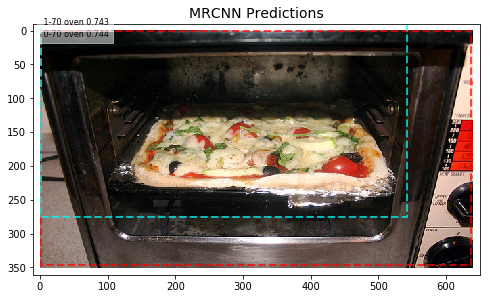

In [23]:
f = fcn_results[0]
print(np.unique(f['gt_class_ids']))
print(np.unique(f['class_ids']))
print('Image Meta: ', f['image_meta'][:10])
visualize.display_instances(f['image'], f['rois'],  f['class_ids'], dataset_test.class_names, f['scores'],
#                             only_classes=[74],
                            title="MRCNN Predictions", score_range=(0.0, 1.7))
#  only_classes=[27],

class ids:  [70]
Image Meta:  [        95        351        640          3        231          0        793       1024          1          1]


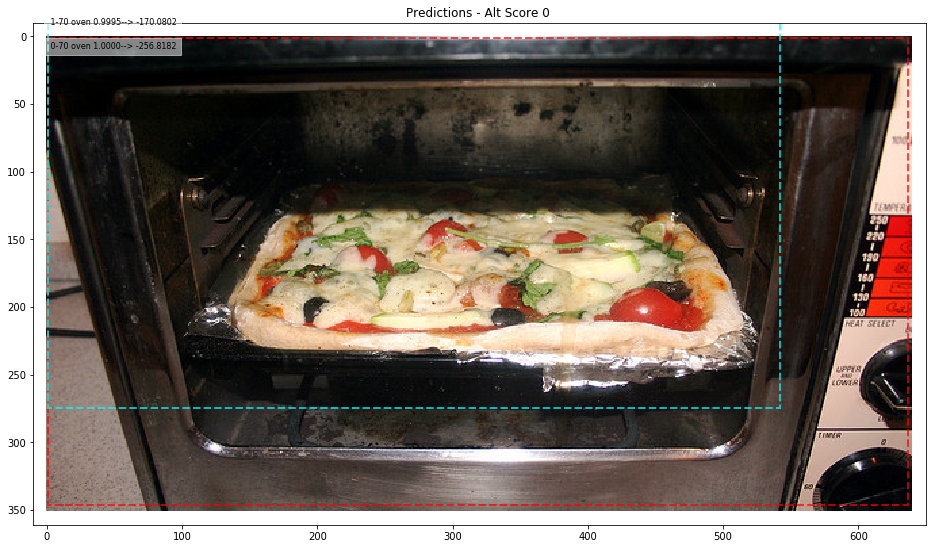

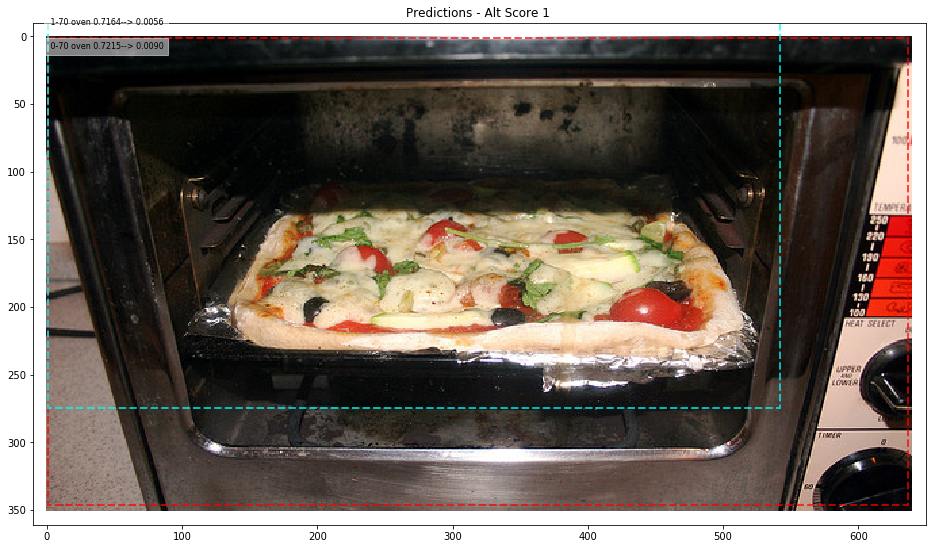

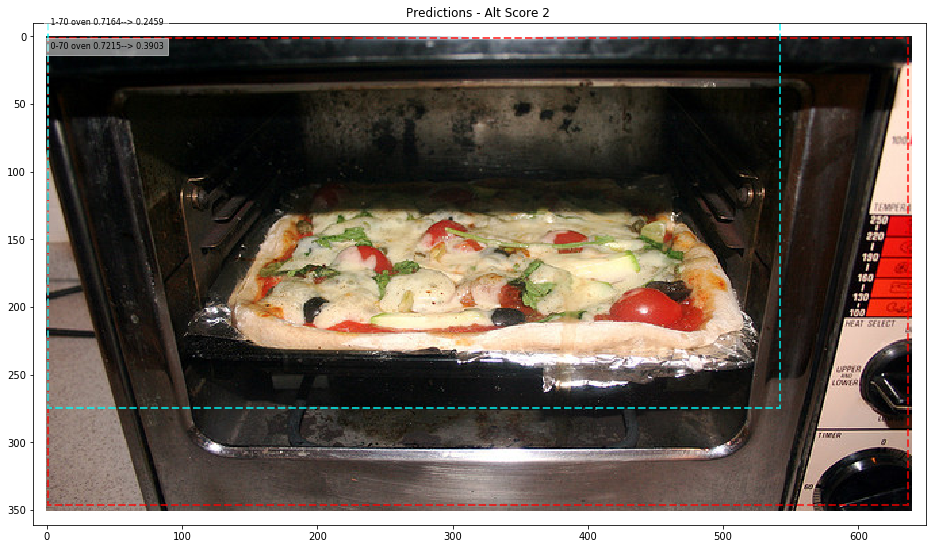

In [24]:
#### Display detections
## old_score   : 11
## alt_score_1 : 14
## alt_score_2 : 20
from mrcnn.utils import log # Display results
# ax = visualize.get_ax(rows =1, cols = 1, size= 20)
f = fcn_results[0]
clses = None
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
print('Image Meta: ', f['image_meta'][:10])
# visualize.display_instances_from_prscores(f['image'], f['pr_scores'], class_names, score_range=(-999, 9999), only_classes = [1])
# visualize.display_instances(f['image'], f['rois'],  f['class_ids'], class_names, f['scores'], title="Predictions", score_range=(0.7, 0.99), size = 24)
# visualize.display_instances(f['image'], f['rois'], f['class_ids'], class_names, f['scores'], title="Predictions - Orig Score", score_range=(0.0, 1.99), size = 24, only_classes=clses)
visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,11], f['fcn_scores'][:,11],title="Predictions - Alt Score 0 ", only_classes=clses)
visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,14], f['fcn_scores'][:,14],title="Predictions - Alt Score 1 ", only_classes=clses)
visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,20], f['fcn_scores'][:,20],title="Predictions - Alt Score 2 ", only_classes=clses)
# visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,17], f['fcn_scores'][:,17],title="Predictions - Alt Score 1 (Normalized by class)", only_classes=clses)
# visualize.display_instances_two_scores(f['image'], f['rois'], f['class_ids'], class_names, f['pr_scores'][:,23], f['fcn_scores'][:,23],title="Predictions - Alt Score 2 (Normalized by class)", only_classes=clses)


#### Display Img with GT bboxes

 Image_id    :  30533  Reference:  http://cocodataset.org/#explore?id=488487 Coco Id: 488487
 Image meta  :  [     30533        480        640          3        128          0        896       1024          1          1]
 Class ids   :  (2,)    [        35         36]
 Class Names :  ['baseball bat', 'baseball glove']


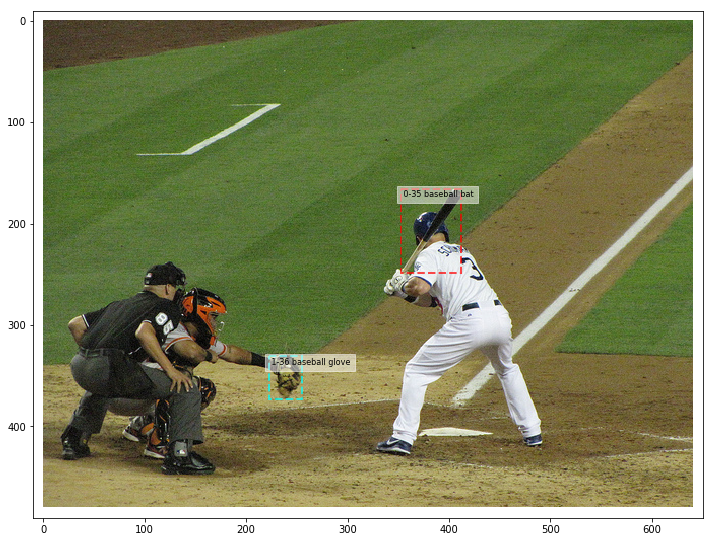

In [19]:
visualize.display_image_gt(dataset_test, mrcnn_model.config, IMAGE_LIST ,
#                            only_classes=[44,46] 
                          )

### Compute mAP and Display Precision/Recall Curve

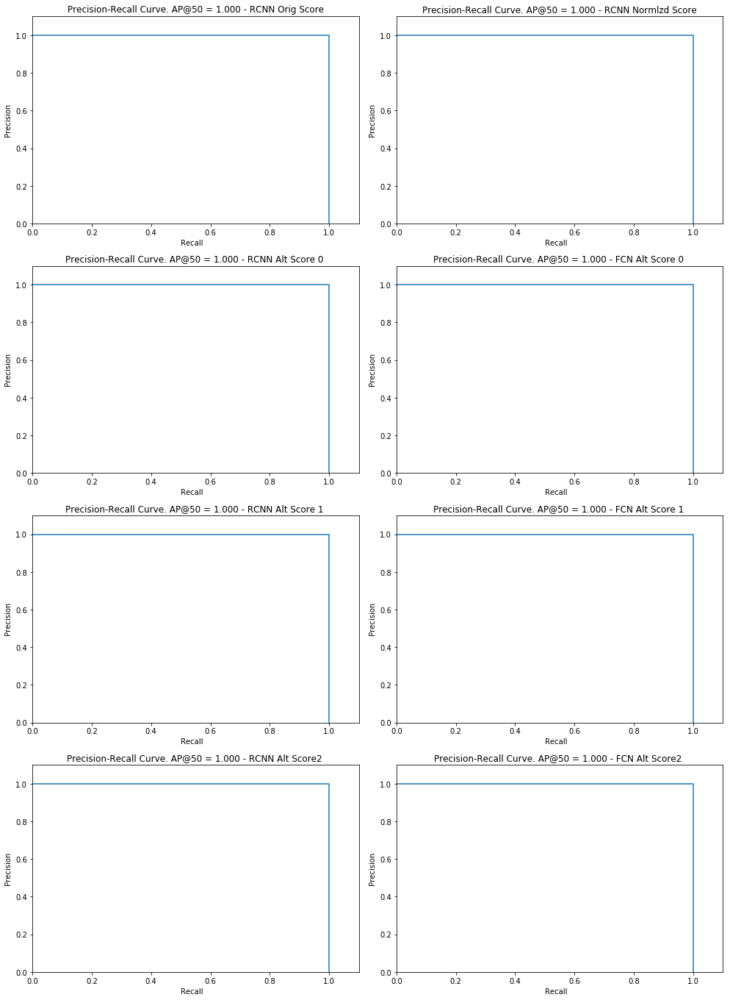

In [13]:
visualize.plot_precision_recall_compare(fcn_results)

In [ ]:
orig_score = 5
norm_score = 8
alt_scr_0  = 11
alt_scr_1  = 14   # in MRCNN alt_scr_1 ans alt_scr_2 are the same
alt_scr_2  = 20

# # Draw precision-recall curve
f = fcn_results[0]
AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['scores'])
visualize.plot_precision_recall(AP, precisions, recalls,ttl = "- Orig Score")
# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,norm_score])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- Normlzd Score")

# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,alt_scr_0])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- RCNN Alt Score 0 ")
# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['fcn_scores'][:,alt_scr_0])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- FCN Alt Score 0 ")

# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,alt_scr_1])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- RCNN Alt Score 1 ")
# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['fcn_scores'][:,alt_scr_1])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- FCN Alt Score 1 ")


# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,alt_scr_2])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- RCNN Alt Score 1 ")
# AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['fcn_scores'][:,alt_scr_2])
# visualize.plot_precision_recall(AP, precisions, recalls, ttl = "- FCN Alt Score 1 ")

##  Run MRCNN detection pipeline on second image

In [ ]:
from mrcnn.prep_notebook import get_evaluate_batch
# from mrcnn.prep_notebook import get_training_batch, get_inference_batch, get_evaluate_batch
IMAGE_LIST = [4745]
# eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, generator = test_generator, display = True)
eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, IMAGE_LIST, display = True)

In [ ]:
fcn_results = fcn_model.evaluate(mrcnn_model, eval_batch, verbose =0)

### Display detections on Image

In [ ]:
f = fcn_results[0]
print('Image Meta: ', f['image_meta'][:10])
visualize.display_instances(f['image'], f['rois'],  f['class_ids'], dataset_test.class_names, f['scores'], title="MRCNN Predictions", score_range=(0.0, 0.7))
#  only_classes=[27],

In [ ]:
#### Display detections
## old_score   : 11
## alt_score_1 : 14
## alt_score_2 : 20
from mrcnn.utils import log # Display results
# ax = visualize.get_ax(rows =1, cols = 1, size= 20)
r = fcn_results[0]
clses = [42]
class_ids = np.unique(r['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
print('Image Meta: ', r['image_meta'][:10])

# visualize.display_instances(r['image'], r['rois'],  r['class_ids'], class_names, r['scores'], title="Predictions", score_range=(0.7, 0.99), size = 24)
visualize.display_instances(r['image'], r['rois'],  r['class_ids'], class_names, r['scores'], title="Predictions", score_range=(0.0, 0.99), only_classes= [42], size = 24)
# visualize.display_instances_two_scores(r['image'], r['rois'], r['class_ids'], class_names, r['pr_scores'][:,11], r['fcn_scores'][:,11],title="Predictions", only_classes=clses,size = 24)
visualize.display_instances_two_scores(r['image'], r['rois'], r['class_ids'], class_names, r['pr_scores'][:,14], r['fcn_scores'][:,14],title="Predictions", only_classes=clses,size = 24)
visualize.display_instances_two_scores(r['image'], r['rois'], r['class_ids'], class_names, r['pr_scores'][:,20], r['fcn_scores'][:,20],title="Predictions", only_classes=clses,size = 24)

### Compute mAP and Display Precision/Recall Curve

In [ ]:
old_score   = 11
alt_score_1 = 14
alt_score_2 = 20
# Draw precision-recall curve
f = fcn_results[0]
AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['scores'])
visualize.plot_precision_recall(AP, precisions, recalls)
AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,alt_score_1])
visualize.plot_precision_recall(AP, precisions, recalls)
AP, precisions, recalls, overlaps = utils.compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['fcn_scores'][:,alt_score_1])
visualize.plot_precision_recall(AP, precisions, recalls)

##  Run MRCNN detection pipeline on third image

### Load image using `get_evaluate_batch()`

In [ ]:
# 13378, 33816
image, _ = get_inference_batch(dataset_test, mrcnn_model, 13378, display=True)    

In [ ]:
results= run_mrcnn_detection(mrcnn_model,dataset_test, image_id=13378, verbose = 0)
r = results[0]

In [ ]:
print('Image Meta: ', r['orig_image_meta'][:10])
visualize.display_instances(r['image'], r['rois'],  r['class_ids'], dataset_test.class_names, r['scores'], 
                             title="Predictions", score_range=(0.0, 0.7))


#  Compute AP routine

In [94]:
from mrcnn.utils import trim_zeros, compute_overlaps
np_format = {}
float_formatter = lambda x: "%10.4f" % x
int_formatter   = lambda x: "%10d" % x
np_format['float'] = float_formatter
np_format['int']   = int_formatter
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)
def compute_ap(gt_boxes, gt_class_ids,
               pred_boxes, pred_class_ids, pred_scores,
               iou_threshold=0.5):
    '''
    Compute Average Precision at a set IoU threshold (default 0.5).

    Returns:
    mAP:            Mean Average Precision
    precisions:     List of precisions at different class score thresholds.
    recalls:        List of recall values at different class score thresholds.
    overlaps:       [pred_boxes, gt_boxes] IoU overlaps.
    '''
    # Trim zero padding and sort predictions by score from high to low
    # TODO: cleaner to do zero unpadding upstream
    gt_boxes   = trim_zeros(gt_boxes)
    gt_class_ids = trim_zeros(np.expand_dims(gt_class_ids, axis = -1))
    pred_boxes = trim_zeros(pred_boxes)
    pred_scores= pred_scores[:pred_boxes.shape[0]]
    indices    = np.argsort(pred_scores)[::-1]   ## sort indices from largest to smallest
#     print('arg_sort indicies:', indices)
    pred_boxes     = pred_boxes[indices]
    pred_class_ids = pred_class_ids[indices]
    pred_scores    = pred_scores[indices]
    print(gt_boxes.shape, gt_class_ids.shape)
    print(pred_boxes.shape, pred_class_ids.shape, pred_scores.shape)
    print('ground truth:')
    print(np.concatenate([gt_boxes,gt_class_ids], axis = -1))    
    print('predcitions:')
    print(np.concatenate([pred_boxes,np.expand_dims(pred_class_ids, axis = -1), np.expand_dims(pred_scores, axis = -1)], axis = -1))
    print(' Total predicitons: ' , len(pred_scores))
    
    # Compute IoU overlaps [pred_boxes, gt_boxes]
    overlaps = compute_overlaps(pred_boxes, gt_boxes)
    print('overlaps: ',overlaps.shape)
    print(overlaps)
    
    # Loop through ground truth boxes and find matching predictions
    match_count = 0
    pred_match = np.zeros([pred_boxes.shape[0]])
    gt_match   = np.zeros([gt_boxes.shape[0]])
    
    for i in range(len(pred_boxes)):
        # Find best matching ground truth box
        sorted_ixs = np.argsort(overlaps[i])[::-1]
        for j in sorted_ixs:
            # If ground truth box is already matched, go to next one
            if gt_match[j] == 1:
                continue
            # If we reach IoU smaller than the threshold, end the loop
            iou = overlaps[i, j]
            if iou < iou_threshold:
                break
            # Do we have a match?
            if pred_class_ids[i] == gt_class_ids[j]:
                match_count  += 1
                gt_match[j]   = 1
                pred_match[i] = 1
                break
    print(' after overlap computation')
    print('match count:', match_count)
    print('pred_match :', pred_match)
    print('  gt_match :', gt_match)
    
    # Compute precision and recall at each prediction box step
    # Precision = TP / (TP+FP)      Recall = TP / (TP + FN)
    precisions = np.cumsum(pred_match) / (np.arange(len(pred_match)) + 1)
    recalls    = np.cumsum(pred_match).astype(np.float32) / len(gt_match)
    
    print(' precisions')
    print(np.cumsum(pred_match), '/', (np.arange(len(pred_match)) + 1))
    print(precisions)
    print()
    print(' recalls ')
    print(np.cumsum(pred_match), '/', len(gt_match))
    print(recalls)
    print()
    
    # Pad with start and end values to simplify the math
    precisions = np.concatenate([[0], precisions, [0]])
    recalls    = np.concatenate([[0], recalls, [1]])
    print('appended [0/0], [0/1] to front/end of precisions/recalls')
    print(' Pr: ', precisions)
    print(' Rc: ', recalls)
    print()
    
    
    # Ensure precision values decrease but don't increase. This way, the
    # precision value at each recall threshold is the maximum it can be
    # for all following recall thresholds, as specified by the VOC paper.
    for i in range(len(precisions) - 2, -1, -1):
        precisions[i] = np.maximum(precisions[i], precisions[i + 1])
    print('backtracking precsiosn values:', list(range(len(precisions) - 2, -1, -1)))
    print(' Pr: ', precisions)
    print(' Rc: ', recalls)
    print()
    
    # Compute mean AP over recall range
    print(' Rc[:-1] : ', recalls[:-1])
    print(' Rc[1:]  : ', recalls[1:])
    print(' Pr[1:]  : ', precisions[1:])
    print()

    ## find points where recall values changes 
    indices = np.where(recalls[:-1] != recalls[1:])[0] + 1
    mAP     = np.sum((recalls[indices] - recalls[indices - 1]) * precisions[indices])
    
    print('where recalls[:-1] != recalls[1:]:', np.where(recalls[:-1] != recalls[1:]))
    print('indices at recall changes : ', indices)
    print(' A1: recall[indices]  : ', recalls[indices])
    print(' A2: recall[indices-1]: ', recalls[indices-1])
    print(' A1 - A2              : ', (recalls[indices] - recalls[indices - 1]))
    print(' P1:precision[indices]: ', precisions[indices])
    print(' (A1-A2)*P1           : ', (recalls[indices] - recalls[indices - 1]) * precisions[indices])
    print(' Sum = mAP            : ', mAP)
    print(' Pr        : ', precisions)
    print(' Rc        : ', recalls)
    print(' Pr*Rc     : ', precisions*recalls)
    print(' Sum(Pr*Rc): ', np.sum(precisions*recalls))
    print(' Sum(Pr*Rc)/m: ', np.sum(precisions*recalls)/len(precisions))
    return mAP, precisions, recalls, overlaps

(100, 4) (100,)
(8, 4) (8, 1)
(21, 4) (21,) (21,)
ground truth:
[[       445        787        687        915         40]
 [       378        735        644        856         40]
 [       170          5        520        342          1]
 [       363          0        847        398          1]
 [       676        261        770        403         44]
 [       493        378        762        723         56]
 [       170        659        349        959          1]
 [       170        775        451       1023          1]]
predcitions:
[[  218.0000    10.0000   853.0000   359.0000     1.0000     0.9897]
 [  426.0000   787.0000   698.0000   916.0000    40.0000     0.9753]
 [  380.0000   168.0000   646.0000   289.0000    40.0000     0.9753]
 [  337.0000   109.0000   579.0000   237.0000    40.0000     0.9753]
 [  172.0000   693.0000   428.0000  1013.0000     1.0000     0.9641]
 [  262.0000   301.0000   531.0000   646.0000    56.0000     0.9570]
 [  484.0000   342.0000   764.0000   728.000

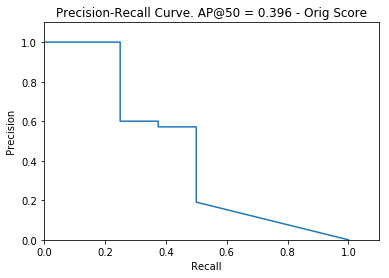

In [96]:
orig_score = 5
norm_score = 8
alt_scr_0  = 11
alt_scr_1  = 14   # in MRCNN alt_scr_1 ans alt_scr_2 are the same
alt_scr_2  = 20

# AP, precisions, recalls, overlaps = compute_ap(gt_data[0]['gt_bbox'], gt_data[0]['gt_class_id'], r['molded_rois'], r['class_ids'], r['scores'])
f = fcn_results[0]
print(f['gt_bboxes'].shape, f['gt_class_ids'].shape)
AP, precisions, recalls, overlaps = compute_ap(f['gt_bboxes'], f['gt_class_ids'], f['molded_rois'], f['class_ids'], f['pr_scores'][:,orig_score])
visualize.plot_precision_recall(AP, precisions, recalls,ttl = "- Orig Score")

In [ ]:
len(precisions)
precisions


In [ ]:
f = fcn_results[0]
f.keys()

# Display Heatmaps

In [23]:
# from mrcnn.visualize import (plot_one_bbox_heatmap, 
#                              plot_3d_heatmap, plot_2d_heatmap, 
#                               plot_2d_heatmap_compare, plot_3d_heatmap_compare)
# import matplotlib as plt
# %matplotlib inline
img_id = 0
f= fcn_results[img_id]
image_id=f['image_meta'][0]
print('Image id: ',image_id, ' Coco ID: ', dataset_test.image_info[image_id]['id'])
print(f['pr_scores'][:,4])
coco_class_names = dataset_test.class_names
gt_class_ids = np.unique(f['gt_class_ids']).astype(int).tolist()
pr_class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
fcn_class_ids = np.unique(f['fcn_scores'][:,4]).astype(int).tolist()
print('  GT class ids: ', gt_class_ids)
print('Pred class ids: ', pr_class_ids)
print('FCN  class ids: ', fcn_class_ids)

Image id:  30533  Coco ID:  488487
[   35.0000    35.0000    36.0000    36.0000]
  GT class ids:  [0, 35, 36]
Pred class ids:  [35, 36]
FCN  class ids:  [35, 36]


## Overlay images with heatmaps

### Overlay image with pred_heatmaps

class ids:  [1, 35, 36]
 Scaling options are:  'all', 'class'/'each' , or  'clip' 
 heatmap shape:  (256, 256, 81)  Bounding boxes shape:  (81, 200, 24)
Display classes: [1, 35, 36]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


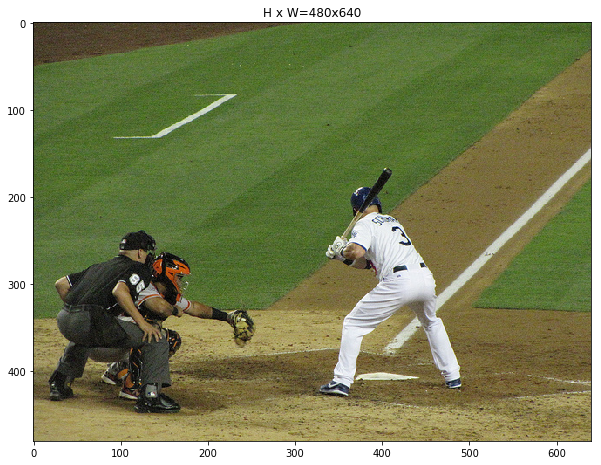

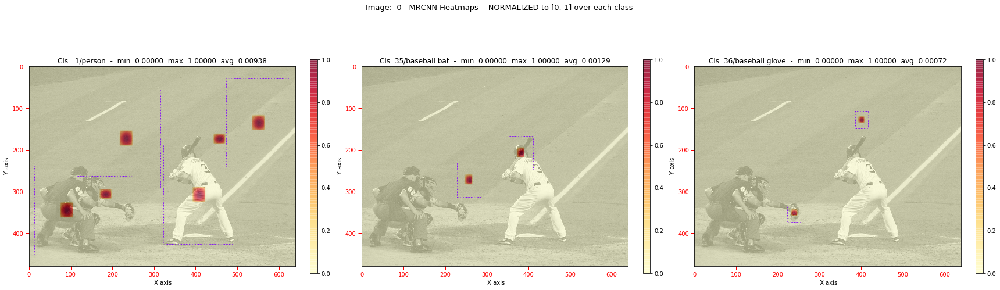

In [19]:
from mrcnn.visualize import display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn, inference_heatmaps_display
# visualize.display_image_bw(image)
# print(model_gt_heatmap_scores.shape)
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
inference_heatmaps_display(fcn_results, 0, class_ids = class_ids, class_names = coco_class_names, hm = 'pr_hm' ,config = mrcnn_model.config, scaling = 'class', columns = 4) 
# , display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr',  
#                      config = mrcnn_config, class_ids = class_ids)

### Overlay image with fcn_heatmaps

class ids:  [1, 35, 36]
 Scaling options are:  'all', 'class'/'each' , or  'clip' 
 heatmap shape:  (256, 256, 81)  Bounding boxes shape:  (81, 200, 24)
Display classes: [1, 35, 36]


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


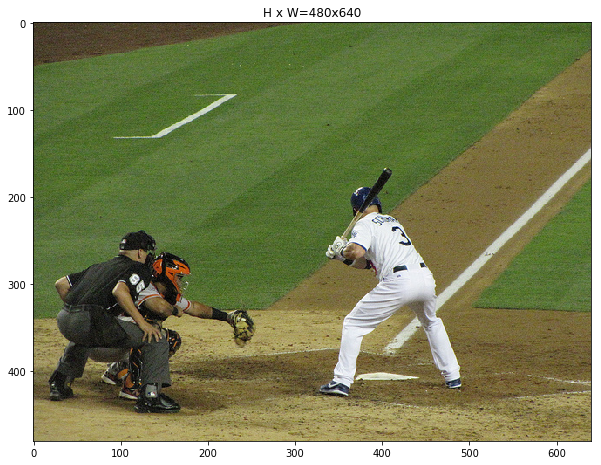

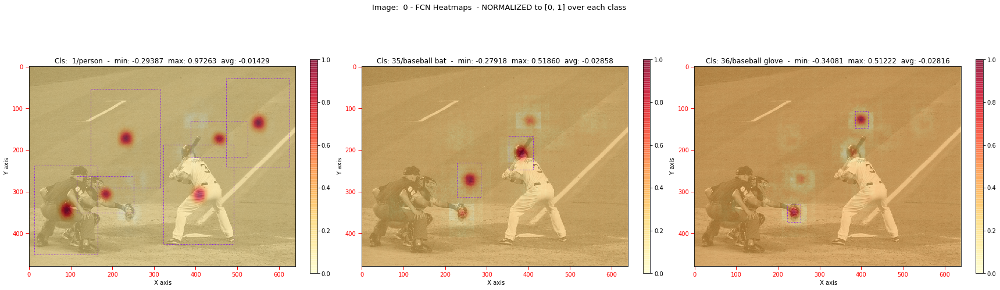

In [20]:
from mrcnn.visualize import display_heatmaps, display_heatmaps_fcn, display_heatmaps_mrcnn, inference_heatmaps_display
# visualize.display_image_bw(image)
# print(model_gt_heatmap_scores.shape)
class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
print('class ids: ', class_ids)
inference_heatmaps_display(fcn_results, 0, class_ids = class_ids, class_names = coco_class_names, hm = 'fcn_hm' ,config = mrcnn_model.config, scaling = 'class', columns = 4) 
# , display_heatmaps_mrcnn(train_batch_x, model_output, 0, hm = 'pr',  

### Overlay image with pr_heatmaps and fcn_heatmaps

 Scaling options are: 'all', 'class', 'each' , or  'clip' : 
 heatmap shape:  (256, 256, 81)
 Bounding boxes shape:  (81, 200, 24)
Image shape : (338, 451, 3)  class_ids: [        42         43         44         45         46         50         56         61         74         80]
 SCALING == clip (clip to [-1, +1])


D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
D:\Program Files\Anaconda3\envs\TF\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


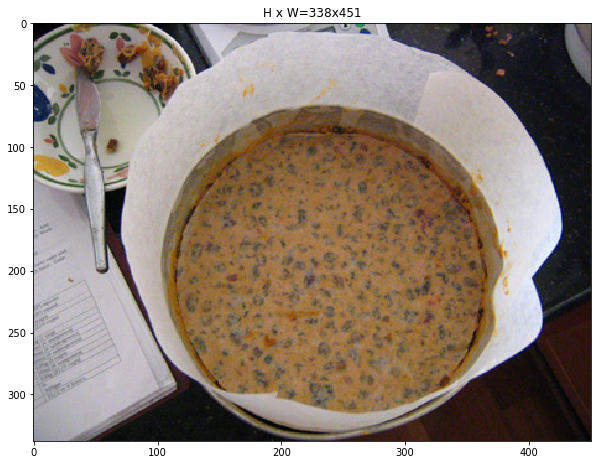

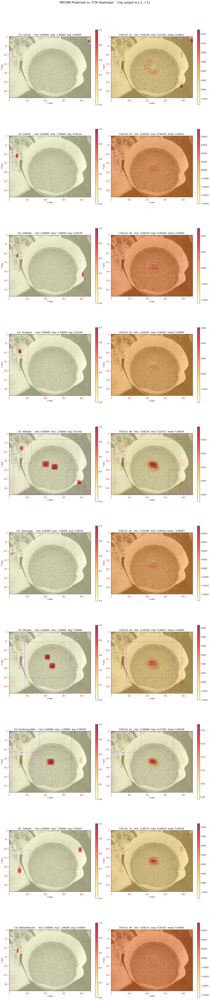

In [66]:
visualize.inference_heatmaps_compare(fcn_results, image_id = 0 , hm = 'fcn_hm', 
                     config = mrcnn_model.config, class_ids = pr_class_ids, class_names = coco_class_names, scaling = 'clip')

## 2D Plots

###  2D plot of `model_gt_heatmap`  

In [25]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
visualize.plot_2d_heatmap(model_gt_heatmap, model_gt_heatmap_scores, img_id, gt_class_ids, 
                 class_names = coco_class_names, columns = 3, scale = 4, scaling = 'all')

Image : 0  ClassIds: [0, 1, 35, 36]


NameError: name 'model_gt_heatmap' is not defined

###  2D plot of `model_pred_heatmap` (w/ Ground Truth Bounding Boxes)

Image : 0  ClassIds: [1, 35, 36]
 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Shape of Z:  (256, 256, 81)  boxes:  (81, 200, 24)
 Image Id:  0  Display classes: [0, 1, 35, 36]
 rows   1  columns : 5 boxes.shape :  (81, 200, 24)
 min_z_all shape: ()  min_z_all: 0.0  max_z_all: () max_z_all: 1.0
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 


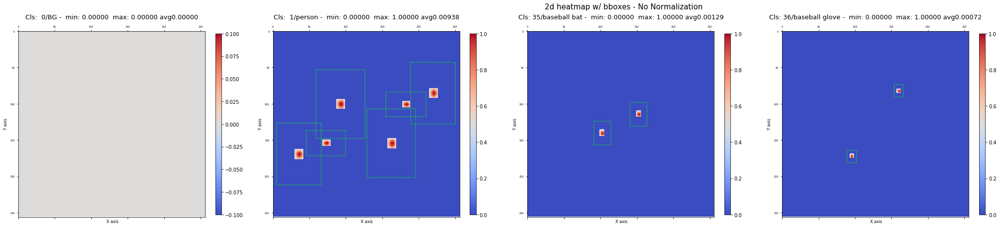

In [27]:
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
_ = visualize.plot_2d_heatmap(f['pr_hm'], f['pr_hm_scores'],0, gt_class_ids, columns = 5,
                             class_names = coco_class_names, scale = 4, scaling = 'none')

###  2D plot of `model_fcn_heatmap` (w/ GT Bounding Boxes)

Image : 0  ClassIds: [0, 35, 36]
 Scaling options are 'all', 'class'/'each', 'clip', or 'none' 
 Shape of Z:  (256, 256, 81)  boxes:  (81, 200, 24)
 Image Id:  0  Display all classes...
 rows   27  columns : 3 boxes.shape :  (81, 200, 24)
 min_z_all shape: ()  min_z_all: -0.42591012  max_z_all: () max_z_all: 0.6756249
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 


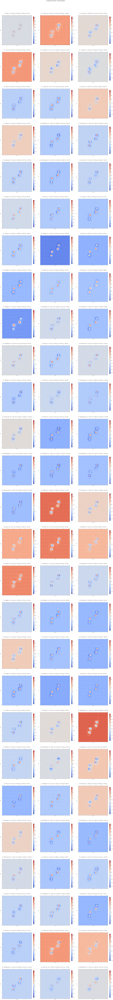

In [27]:
print('Image : {}  ClassIds: {}'.format(img_id, gt_class_ids))
disp_classes = None 

_ = visualize.plot_2d_heatmap(f['fcn_hm'], f['fcn_hm_scores'],img_id, disp_classes, columns = 3, size=(9,9),
                             class_names = coco_class_names, scale = 4, scaling = 'none')

###  2D plot of `model_fcn_heatmap` (w/ MRCNN PREDICTED Bounding Boxes)

In [ ]:
print(model_fcn_heatmap.shape)
print('Image : {}  ClassIds: {}'.format(img_id, pr_class_ids))
fig  = visualize.plot_2d_heatmap(model_fcn_heatmap, model_fcn_scores,img_id, pr_class_ids, columns = 5,
                             class_names = coco_class_names, scale = 4, scaling = 'class')

####  2D plot of `model_fcn_heatmap` returned from model - ALL CLASSES

In [ ]:
# class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
# print('Image : {}  Pred ClassIds: {}'.format(img_id, class_ids))
# fig  = visualize.plot_2d_heatmap(model_fcn_heatmap, model_fcn_scores, img_id, 
#                                  columns = 5, class_names = coco_class_names, scale = 4, scaling = 'class')    
#     fig.savefig('fcn_heatmaps_2d.png')

####  2D comparative display `pred_heatmap` / `fcn_heatmap`  

In [ ]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    class_ids = np.unique(model_pred_heatmap_scores[img_id,:,:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
#     class_ids = list(range(30))
    _ = visualize.plot_2d_heatmap_compare(model_pred_heatmap, model_fcn_heatmap, model_pred_heatmap_scores, 
                            img_id, class_ids = class_ids, class_names = coco_class_names, scale = 4, scaling = 'class' )    

##  3D Plots

###  3D plot of `fcn_heatmap` returned form model - classes predicted by MRCNN only 

0.6756249 -0.42591012
(256, 256, 81)
Image : 0  ClassIds: [         0          1          2          3          4          5          6          7          8          9]
 Scaling options are 'all', 'class', or 'clip'/ None 
Display classes: [         0          1          2          3          4          5          6          7          8          9]
rows   5  columns : 2
3
 min_z_all shape: ()  min_z_all: -0.42591012  max_z_all: () max_z_all: 0.6756249
 min_z_cls shape: (1, 1, 81)  max_z_cls shape: (1, 1, 81)
 SCALING == none 
width/height:  24 60
1 zlim = each  zlim_min : -0.08326931 zlim_max: 0.08794007 
1 zlim = each  zlim_min : -0.27842391 zlim_max: 0.07221371 
1 zlim = each  zlim_min : -0.19862005 zlim_max: 0.15714619 
1 zlim = each  zlim_min : -0.38418144 zlim_max: 0.10752416 
1 zlim = each  zlim_min : -0.27736437 zlim_max: 0.20947430 
1 zlim = each  zlim_min : -0.18596499 zlim_max: 0.16055909 
1 zlim = each  zlim_min : -0.24853837 zlim_max: 0.32411286 
1 zlim = each  zlim_min :

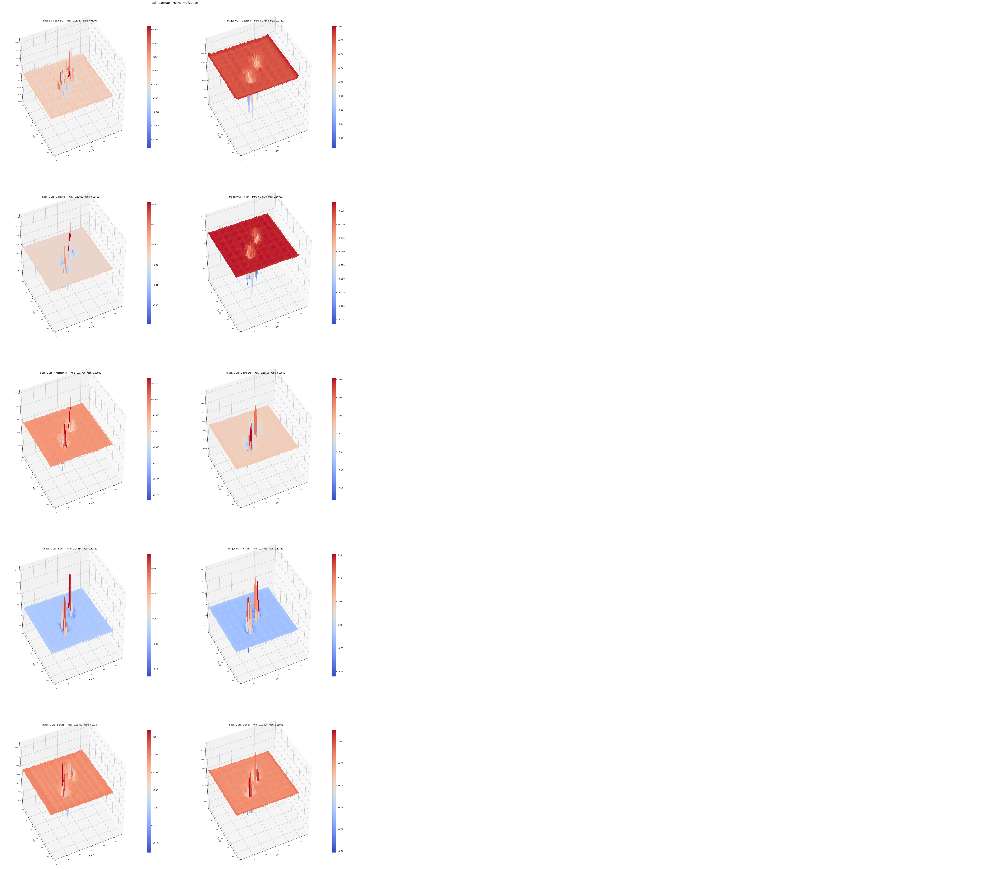

In [36]:
print(np.max(f['fcn_hm']), np.min(f['fcn_hm']))

print(f['fcn_hm'].shape)
class_ids = pr_class_ids
class_ids = None 
class_ids = np.arange(10)
print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
visualize.plot_3d_heatmap(f['fcn_hm'], 0, class_ids,class_names = coco_class_names, scaling = 'none')

###  3D plot of `fcn_softmax` returned form model - only classes in pred_scores

In [ ]:
for img_id in [0]: ##range(mrcnn_config.BATCH_SIZE):
    print(f['fcn_hm'].shape)
    class_ids = np.unique(f['pr_scores'][:,4]).astype(int).tolist()
    print('Image : {}  ClassIds: {}'.format(img_id, class_ids))
    plot_3d_heatmap(f['fcn_sm'], 0, class_ids,class_names = coco_class_names, scaling = 'none')

# Run Object Detection on samples in Images folder

### Test on a random image from images folder

In [ ]:
# Load a random image from the images folder
# import mrcnn.visualize as visualize
import random
import skimage.io
import matplotlib.pyplot as plt
IMAGE_DIR = 'E:/git_projs/mrcnn3/images'
# IMAGE_DIR = '/esat/tiger/joramas/mscStudentsData/kbardool/projs/mrcnn3/images'
file_names = next(os.walk(IMAGE_DIR))[2]
# print(file_names)
random_filename = random.choice(file_names)
print(random_filename)
image = skimage.io.imread(os.path.join(IMAGE_DIR, random_filename))
plt.figure(figsize=(11,11))
plt.imshow(image)

In [ ]:
# Run detection
# results = mrcnn_model.detect([image], verbose=1)
results = fcn_model.detect_from_images(mrcnn_model, [image], verbose=1)

###  Test on loaded image

In [ ]:
# Visualize results
r = results[0]
for bbox, cls, scr in zip(r['rois'], r['class_ids'],  r['scores']):
    print('{}    {:2d}    {:.<20s}  {:5.4f} '.format(bbox, cls, dataset_test.class_names[cls], scr))
visualize.display_instances(image, r['rois'], r['class_ids'], dataset_test.class_names, r['scores']) #, score_range=(0.21, 0.22))

In [ ]:
r = results[0]
for bbox, cls, scr in zip(r['rois'], r['class_ids'],  r['scores']):
    print('{}    {:2d}    {:.<20s}  {:5.4f} '.format(bbox,cls,dataset_test.class_names[cls], scr))
visualize.display_instances(image, r['rois'], r['class_ids'], dataset_test.class_names, r['scores'], ax=visualize.get_ax(size=16))

###  Display random image from test dataset

In [ ]:
# Load random image and mask. ### 27711 persons and boats
image_id = np.random.choice(dataset_test.image_ids)
image    = dataset_test.load_image(image_id)
mask, class_ids = dataset_test.load_mask(image_id)
# Compute Bounding box
bbox = utils.extract_bboxes(mask)

# Display image and additional stats
print("image_id ", image_id, dataset_test.image_reference(image_id))
log("image", image)
log("mask", mask)
log("class_ids", class_ids)
log("bbox", bbox)
print(class_ids.shape[0], bbox.shape[0])
# Display image and instances
# visualize.display_instances_with_mask(image, bbox, mask, class_ids, dataset_train.class_names)
visualize.display_instances(image, bbox, class_ids, dataset_test.class_names)

In [ ]:
results = mrcnn_model.detect([image], verbose=1)

In [ ]:
print('resutls :', results)
# Visualize results
r = results[0]
for bbox, cls, scr in zip(r['rois'], r['class_ids'],  r['scores']):
    print('{}    {:2d}    {:.<20s}  {:5.4f} '.format(bbox,cls,dataset_test.class_names[cls], scr))
visualize.display_instances(image, r['rois'], r['class_ids'], dataset_test.class_names, r['scores'])

### Test on a random image from test dataset

In [ ]:
# Test on a random image
# Validation dataset
# dataset_val = shapes.ShapesDataset()
# dataset_val.load_shapes(50, config.IMAGE_SHAPE[0], config.IMAGE_SHAPE[1])
# dataset_val.prepare()

image_id = random.choice(dataset_test.image_ids)
original_image, image_meta, gt_class_id, gt_bbox =\
    load_image_gt(dataset_test, mrcnn_config, image_id, use_mini_mask=False)
    

print('Image Id :', image_id)    
shape_list = dataset_test.image_info[image_id] 
pp.pprint(shape_list)
log("original_image", original_image)
log("image_meta", image_meta)
print(image_meta)
log("gt_class_id", gt_bbox)
log("gt_bbox", gt_bbox)
# log("gt_mask", gt_mask)

print(" 1: person   2: car  3: sun  4: building  5: tree  6: cloud ")
visualize.display_instances(original_image, gt_bbox, gt_class_id, 
                            dataset_test.class_names, figsize=(8, 8))

In [ ]:
results = model.detect([original_image], verbose=1)

In [ ]:
r = results[0]
print('  rois       : ', r['rois'])
print('  masks      : ', r['masks'].shape)
print('  class ids  : ', r['class_ids'])
print('  class names: ', dataset_test.class_names)
print('  scores     : ', r['scores'])
visualize.display_instances(original_image, r['rois'], r['masks'], r['class_ids'], 
                            dataset_test.class_names, r['scores'], ax=get_ax())

# Evaluation of mAP  over a number of images

##  Modified Version for MRCNN - FCN 

In [14]:
# Compute VOC-Style mAP @ IoU=0.5
# Running on 10 images. Increase for better accuracy.
from mrcnn.datagen     import data_generator, load_image_gt
import  mrcnn.utils as utils 

orig_score = 5
norm_score = 8
alt_scr_0  = 11
alt_scr_1  = 14   # in MRCNN alt_scr_1 ans alt_scr_2 are the same
alt_scr_2  = 20

image_ids = np.random.choice(dataset_test.image_ids, 50)
print(image_ids)
# APs = []
MRCNN_AP_Orig = []
MRCNN_AP_0 = [] 
MRCNN_AP_1 = [] 
MRCNN_AP_2 = []
FCN_AP_0   = []
FCN_AP_1   = []
FCN_AP_2   = []
for image_id in image_ids:
    # Load image and ground truth data
    print('==> Calculate AP for image_id : ', image_id)
    # Run object detection
    eval_batch = get_evaluate_batch(dataset_test, mrcnn_model.config, image_id, display = False)    
    fcn_results = fcn_model.evaluate(mrcnn_model, eval_batch, verbose =0)    
    r = fcn_results[0] 
    
    # Compute AP
#     AP, precisions, recalls, overlaps
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'], r["molded_rois"], r["class_ids"], r["pr_scores"][:,orig_score])
#     print('   MRCNN_AP_Orig:', AP)
    MRCNN_AP_Orig.append(AP)
    
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'], r["molded_rois"], r["class_ids"], r["pr_scores"][:,alt_scr_0])
#     print('   MRCNN_AP_0   :', AP)
    MRCNN_AP_0.append(AP)
    
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["fcn_scores"][:,alt_scr_0])
#     print('   FCN_AP_0   :', AP)
    FCN_AP_0.append(AP)

    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["pr_scores"][:,alt_scr_1])
#     print('   MRCNN_AP_1   :', AP)
    MRCNN_AP_1.append(AP)
    
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["fcn_scores"][:,alt_scr_1])
#     print('   FCN_AP_1   :', AP)
    FCN_AP_1.append(AP)
    

    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["pr_scores"][:,alt_scr_2])
#     print('   MRCNN_AP_2   :', AP)
    MRCNN_AP_2.append(AP)
    
    AP, _, _, _= utils.compute_ap(r['gt_bboxes'], r['gt_class_ids'],  r["molded_rois"], r["class_ids"], r["fcn_scores"][:,alt_scr_2])
#     print('   FCN_AP_2   :', AP)
    FCN_AP_2.append(AP)
    
# print("mAP: ", np.mean(APs))

[      1875        647       1452        584       1804       1122        103       2032       2349       1849       1553        933       1440        362       2088        865       2214
        882       1366        570          8        919       2173       1098        468       1262        249       1129       1927       1445       1309        971          1       1405
       1622        184       1786       1451        798       1776       1119       1868        166        381       1448        317       2076       1218        904        931]
==> Calculate AP for image_id :  1875
==> Calculate AP for image_id :  647
==> Calculate AP for image_id :  1452
==> Calculate AP for image_id :  584
==> Calculate AP for image_id :  1804
==> Calculate AP for image_id :  1122
==> Calculate AP for image_id :  103
==> Calculate AP for image_id :  2032
==> Calculate AP for image_id :  2349
==> Calculate AP for image_id :  1849
==> Calculate AP for image_id :  1553
==> Calculate AP for image_id :

In [15]:
print('done')
from mrcnn.utils import trim_zeros, compute_overlaps
np_format = {'float': lambda x: "%10.4f" % x, 
             'int'  : lambda x: "%10d" % x }
np.set_printoptions(linewidth=195, precision=4, floatmode='fixed', threshold =10000, formatter = np_format)

done


In [16]:
print(" {:>13s} {:>13s} {:>13s} {:>13s} {:>13s} {:>13s} {:>13s}".format("MRCNN_AP_Orig", "MRCNN_AP_0", "FCN_AP_0", "MRCNN_AP_1", "FCN_AP_1", "MRCNN_AP_2", "FCN_AP_2"))
for i in range(len(MRCNN_AP_Orig)):
    print(" {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f}".format(
        MRCNN_AP_Orig[i], MRCNN_AP_0[i], FCN_AP_0[i], MRCNN_AP_1[i], FCN_AP_1[i], MRCNN_AP_2[i], FCN_AP_2[i]))
print()
print()


print(" {:>13s} {:>13s} {:>13s} {:>13s} {:>13s} {:>13s} {:>13s}".format("MRCNN_AP_Orig", "MRCNN_AP_0", "FCN_AP_0", "MRCNN_AP_1", "FCN_AP_1", "MRCNN_AP_2", "FCN_AP_2"))
print('-'*160)
print(" {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f} {:13.5f}".format(
        np.mean(MRCNN_AP_Orig), np.mean(MRCNN_AP_0), np.mean(FCN_AP_0), np.mean(MRCNN_AP_1), np.mean(FCN_AP_1), np.mean(MRCNN_AP_2), np.mean(FCN_AP_2)))        

 MRCNN_AP_Orig    MRCNN_AP_0      FCN_AP_0    MRCNN_AP_1      FCN_AP_1    MRCNN_AP_2      FCN_AP_2
       1.00000       1.00000       0.50000       0.50000       0.50000       0.50000       0.50000
       0.59286       0.58333       0.68750       0.62500       0.50000       0.62500       0.50000
       0.50000       0.50000       1.00000       0.50000       1.00000       0.50000       1.00000
       0.50000       0.50000       1.00000       1.00000       1.00000       1.00000       1.00000
       0.50000       0.66667       0.83333       0.75000       0.83333       0.75000       0.83333
       0.50000       0.50000       0.50000       1.00000       1.00000       1.00000       1.00000
       0.50000       0.50000       1.00000       0.50000       1.00000       0.50000       1.00000
       0.75000       0.83333       0.83333       0.83333       0.83333       0.83333       0.83333
       1.00000       0.83333       0.66667       0.83333       0.66667       0.83333       0.66667
       1.0

In [17]:
mrcnn_model.config.VERBOSE = 0
mrcnn_model.config.display()


MRCNN Configuration Parameters:
-------------------------------
BACKBONE_SHAPES                [[       256        256]
 [       128        128]
 [        64         64]
 [        32         32]
 [        16         16]]
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [    0.1000     0.1000     0.2000     0.2000]
COCO_DATASET_PATH              /home/kbardool/MLDatasets/coco2014
COCO_MODEL_PATH                /home/kbardool/PretrainedModels/mask_rcnn_coco.h5
DETECTION_MAX_INSTANCES        200
DETECTION_MIN_CONFIDENCE       0.1
DETECTION_NMS_THRESHOLD        0.3
DETECTION_PER_CLASS            200
DIR_DATASET                    /home/kbardool/MLDatasets/coco2014
DIR_PRETRAINED                 /home/kbardool/PretrainedModels
DIR_TRAINING                   /home/kbardool/models_coco
EPOCHS_TO_RUN                  0
EVALUATE_METHOD                1
FCN_INPUT_SHAPE                [       256        256]
GPU_COUNT              

##  Original Version

In [73]:
# # Compute VOC-Style mAP @ IoU=0.5
# # Running on 10 images. Increase for better accuracy.
# from mrcnn.datagen     import data_generator, load_image_gt
# import  mrcnn.utils as utils 

# image_ids = np.random.choice(dataset_test.image_ids, 10)
# APs = []
# for image_id in image_ids:
#     # Load image and ground truth data
#     image, image_meta, gt_class_id, gt_bbox, gt_mask =\
#         load_image_gt(dataset_test, mrcnn_config,
#                                image_id, use_mini_mask=False)
#     molded_images = np.expand_dims(utils.mold_image(image, mrcnn_config), 0)
#     # Run object detection
#     results = mrcnn_model.detect([image], verbose=0)
#     r = results[0]
#     # Compute AP
#     AP, precisions, recalls, overlaps =\
#         utils.compute_ap(gt_bbox, gt_class_id,
#                          r["rois"], r["class_ids"], r["scores"])
#     APs.append(AP)
    
# print("mAP: ", np.mean(APs))